# Author : Nishad Joshi

## Task #4 - Exploratory Data Analysis - Terrorism

<p>Terrorism is, in the broadest sense, the use of intentional violence for political or religious purposes. It is used in this regard primarily to refer to violence during peacetime or in the context of war against non-combatants (mostly civilians and neutral military personnel). The terms "terrorist" and "terrorism" originated during the French Revolution of the late 18th century but gained mainstream popularity in the 1970s during the conflicts of Northern Ireland, the Basque Country and Palestine. The increased use of suicide attacks from the 1980s onwards was typified by the September 11 attacks in New York City and Washington, D.C. in 2001.

There are various different definitions of terrorism, with no universal agreement about it. Terrorism is a charged term. It is often used with the connotation of something that is "morally wrong". Governments and non-state groups use the term to abuse or denounce opposing groups. Varied political organizations have been accused of using terrorism to achieve their objectives. These include right-wing and left-wing political organizations, nationalist groups, religious groups, revolutionaries and ruling governments. Legislation declaring terrorism a crime has been adopted in many states. When terrorism is perpetrated by nation states, it is not considered terrorism by the state conducting it, making legality a largely grey-area issue. There is no consensus as to whether or not terrorism should be regarded as a war crime.</p>

source - wikipedia

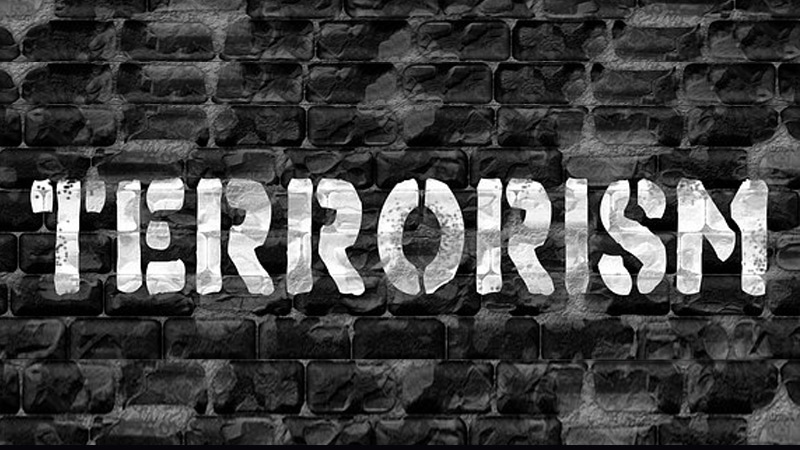

In [53]:
from IPython.display import Image
Image("Terrorism.jpg",width = 1000, height = 300)

In [1]:
# Importing Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gp
import datetime 
import plotly.offline as py
import plotly.express as px
import plotly.figure_factory as ff
from plotly.offline import download_plotlyjs, init_notebook_mode,  plot
from plotly.graph_objs import *
init_notebook_mode()
import warnings
warnings.filterwarnings("ignore")

## Data Cleaning and Pre Processing


In [2]:
# loading the dataset
dataset = pd.read_csv(r"globalterrorismdb_0718dist.csv",encoding='latin1')

In [3]:
dataset_shape = dataset.shape

dataset_columns = list(dataset.columns)

terror_df = dataset[['iyear','imonth','iday','country_txt','region_txt','provstate','city','latitude',
                      'longitude','success','attacktype1_txt','targtype1_txt','gname','weaptype1_txt','motive','nkill','nwound']]

In [4]:
# Renaming the columns
terror_df = terror_df.rename(columns={'iyear':'year',
                          'imonth': 'month',
                          'iday': 'day',
                          'country_txt': 'country',
                          'region_txt': 'region',
                          'provstate': 'state',
                          'attacktype1_txt': 'attackType',
                          'gname': 'groupName',
                          'targtype1_txt': 'target',
                          'weaptype1_txt': 'weaponType',
                          'nkill': 'kills',
                          'nwound': 'wounded'})


In [5]:
# digging deep into the data
print(terror_df.isnull().sum(),'\n\n')
print(terror_df.info(),'\n\n')
print(terror_df.describe(),'\n\n')

year               0
month              0
day                0
country            0
region             0
state            421
city             434
latitude        4556
longitude       4557
success            0
attackType         0
target             0
groupName          0
weaponType         0
motive        131130
kills          10313
wounded        16311
dtype: int64 


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 17 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   year        181691 non-null  int64  
 1   month       181691 non-null  int64  
 2   day         181691 non-null  int64  
 3   country     181691 non-null  object 
 4   region      181691 non-null  object 
 5   state       181270 non-null  object 
 6   city        181257 non-null  object 
 7   latitude    177135 non-null  float64
 8   longitude   177134 non-null  float64
 9   success     181691 non-null  int64  
 10  attackT

In [6]:
# Basic information from the data
print("Most Affected cities: ",end = '')
for i in terror_df['city'].value_counts().index[1:4]: print(i, end = '. ')
print('\n')

print("Countries under most terror (ascending): ", end = '')
for i in terror_df['country'].value_counts().index[0:3]: print(i, end = '. ')
print('\n')

print("Province/state under most terror (ascending): ", end='')
for i in terror_df['state'].value_counts().index[[0,1,3]]: print(i, end = '. ')
print('\n')

print("Year with most number of terror attacks:", terror_df['year'].value_counts().index[0], '\n')

print("Mostly used Weapon Type: ", terror_df['weaponType'].value_counts().index[0],'\n')

print("Most active attack groups: ", terror_df['groupName'].value_counts().index[1], '\n')

print("Mostly targeted are (ascending) : ", end = '')
for i in terror_df['target'].value_counts().index[0:3]: print(i, end='. ')

print("\n\nTotal number of Lives Losts in years due to terror attacks :", terror_df['kills'].sum())

Most Affected cities: Baghdad. Karachi. Lima. 

Countries under most terror (ascending): Iraq. Pakistan. Afghanistan. 

Province/state under most terror (ascending): Baghdad. Northern Ireland. Balochistan. 

Year with most number of terror attacks: 2014 

Mostly used Weapon Type:  Explosives 

Most active attack groups:  Taliban 

Mostly targeted are (ascending) : Private Citizens & Property. Military. Police. 

Total number of Lives Losts in years due to terror attacks : 411868.0


### Above data shows basic information.

## Year wise terror attacks


In [7]:
year_wise = terror_df['year'].value_counts()
year_wise = pd.DataFrame(year_wise)
year_wise = year_wise.sort_index()
year_wise = year_wise.reset_index()
year_wise = year_wise.rename(columns={
    'year': 'total_attacks', 'index': 'year'
    })

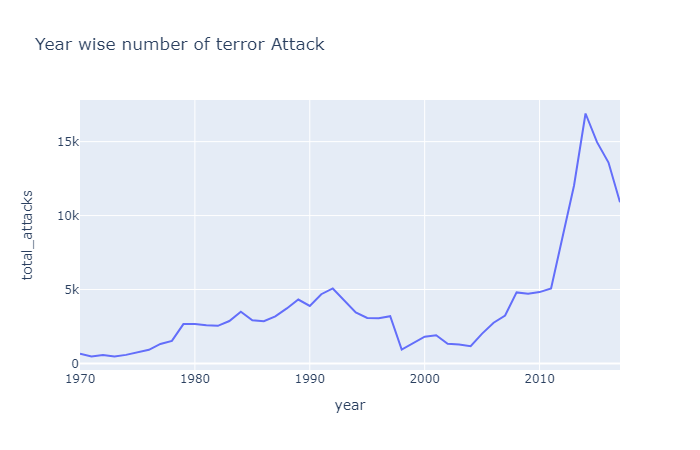

In [119]:
# visualization of Year wise terror attacks
fig = px.line(year_wise, x="year", y="total_attacks", title = "Year wise number of terror Attack" ) 
fig.show('png')

<p> Above plot shows that after 2010 the number of attacks increased with extremely high rate. 

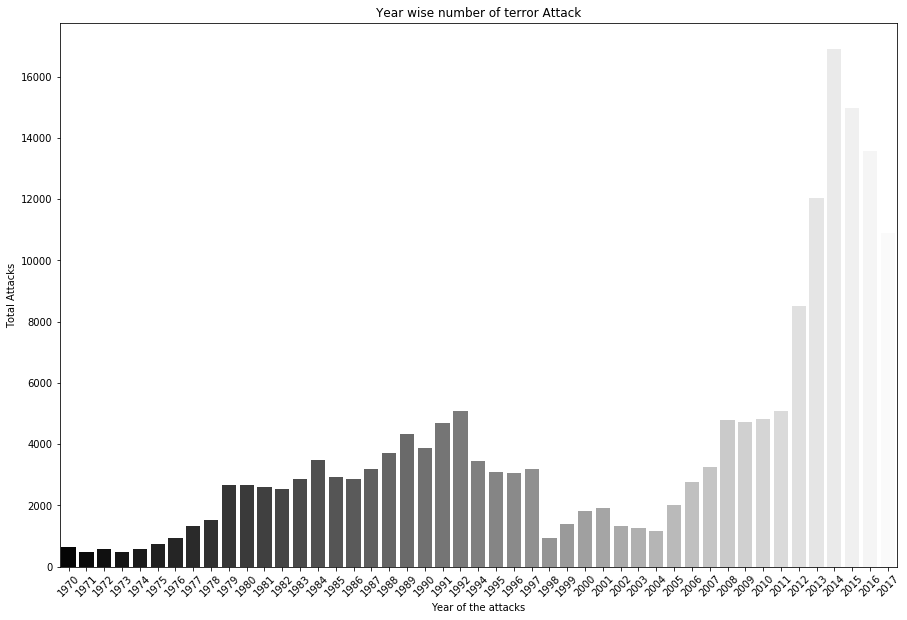

In [9]:
fig = plt.figure(figsize=(15,10))

sns.barplot(year_wise['year'],year_wise['total_attacks'], palette='gist_gray')
plt.xlabel("Year of the attacks")
plt.ylabel("Total Attacks")
plt.title("Year wise number of terror Attack")
plt.xticks(rotation = 45)

plt.show()

<p> The growth in terror activities gradually grew untill 1992 after which it showed sign of decrease.<br>
    The growth in terror activities is seen again from 2004 where in 2014 most cases of terror attacks were reported

## Most affected region

In [10]:
region_wise = terror_df['region'].value_counts()
region_wise = pd.DataFrame(region_wise)
region_wise = region_wise.reset_index()
region_wise = region_wise.rename(columns = {
    'region': 'total_number_of_attacks', 'index': 'region'
    })

In [11]:
top_region = region_wise
top_region

,region,total_number_of_attacks
0,Middle East & North Africa,50474
1,South Asia,44974
2,South America,18978
3,Sub-Saharan Africa,17550
4,Western Europe,16639
5,Southeast Asia,12485
6,Central America & Caribbean,10344
7,Eastern Europe,5144
8,North America,3456
9,East Asia,802


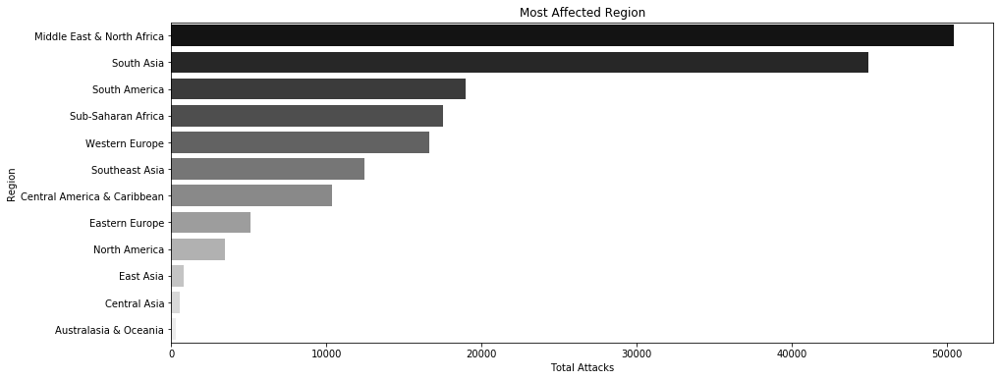

In [12]:
# visualization of Most affected region in world

plt.figure(figsize=(15,6))

sns.barplot(top_region['total_number_of_attacks'], top_region['region'],palette='gist_gray')
plt.ylabel("Region")
plt.xlabel("Total Attacks")
plt.title("Most Affected Region")
plt.show()

<p>This shows that Middle East and North Africa followed by South Asia and South America are the most affected regions in the world</p>

## Country wise terror attacks


In [13]:
country_wise = terror_df['country'].value_counts()
country_wise = pd.DataFrame(country_wise)
#country_wise = country_wise.sort_index()
country_wise = country_wise.reset_index()
country_wise = country_wise.rename(columns = {
    'country':'total_attacks', 'index':'country'
    })

In [14]:
# displays top 30 most affected countries
top_30_countries = country_wise.head(30)
top_30_countries

,country,total_attacks
0,Iraq,24636
1,Pakistan,14368
2,Afghanistan,12731
3,India,11960
4,Colombia,8306
5,Philippines,6908
6,Peru,6096
7,El Salvador,5320
8,United Kingdom,5235
9,Turkey,4292


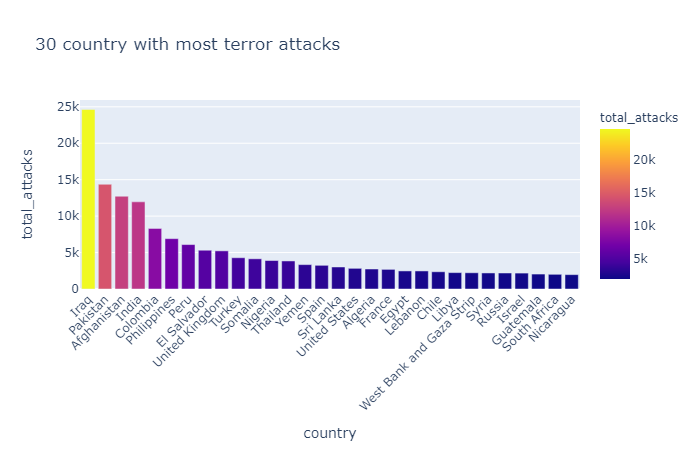

In [123]:
# visualization of top 30 most affected countries
fig = px.bar(top_30_countries, x="country", y="total_attacks", color = "total_attacks", title = "30 country with most terror attacks" ) 
fig.update_layout(barmode='group', xaxis_tickangle=-45)
fig.show('png')

<p> The above plot shows that Iraq, Pakistan and Afghanistan are most affected countries

## City wise terror attacks


In [16]:
city_wise = terror_df['city'].value_counts()
city_wise = pd.DataFrame(city_wise)
city_wise = city_wise.reset_index()
city_wise = city_wise.rename(columns = {
    'city':'total_attacks', 'index':'city'
    })

city_wise = city_wise.drop([0]) # dropped the "unknown" city from the data 

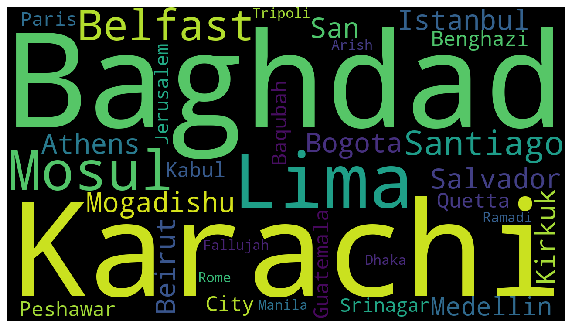

In [17]:
from wordcloud import WordCloud 
cities = city_wise['city'].head(30)
plt.subplots(figsize=(10,10))
wordcloud = WordCloud(background_color = 'black',
                     width = 1280,
                     height = 720).generate(' '.join(cities))
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

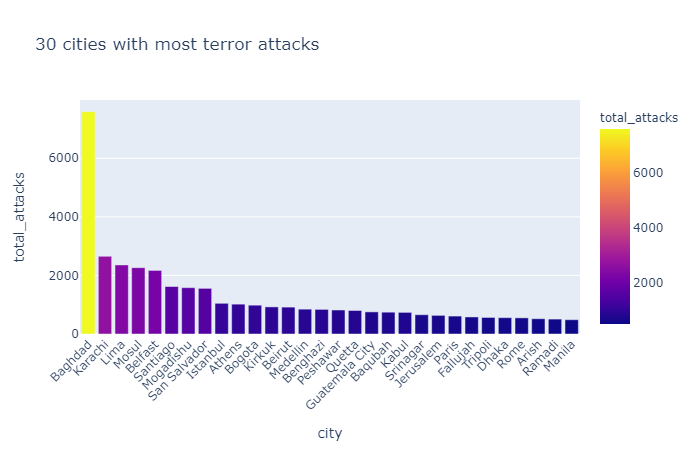

In [117]:
# visualization of City wise terror attacks
top_30_cities = city_wise.head(30)
fig = px.bar(top_30_cities, x="city", y="total_attacks", color = "total_attacks", title = "30 cities with most terror attacks" ) 
fig.update_layout(barmode='group', xaxis_tickangle=-45)
fig.show('png')

<p>The above bar plot shows that Baghdad, Karachi, Lima, and Mosul are cities that emerges as hotspot for the terror attacks.

## Most Active terror Groups
#### Terror group with highest number of attacks

In [19]:
terror_groups = terror_df['groupName'].value_counts()
terror_groups = pd.DataFrame(terror_groups)
terror_groups = terror_groups.reset_index()
terror_groups = terror_groups.rename(columns = {
    'groupName': 'total_attacks', 'index': 'groups'
    })

terror_groups = terror_groups.drop([0])

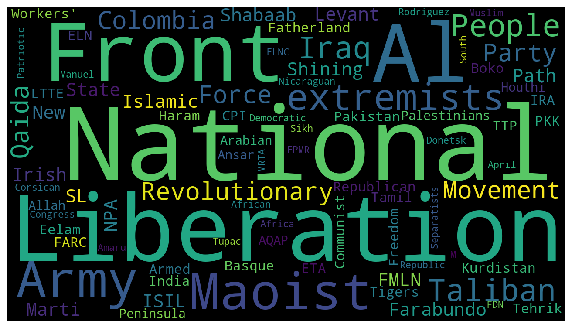

In [20]:
groups = terror_groups['groups'].head(30)
plt.subplots(figsize=(10,10))
wordcloud = WordCloud(background_color = 'black',
                     width = 1280,
                     height = 720).generate(' '.join(groups))
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

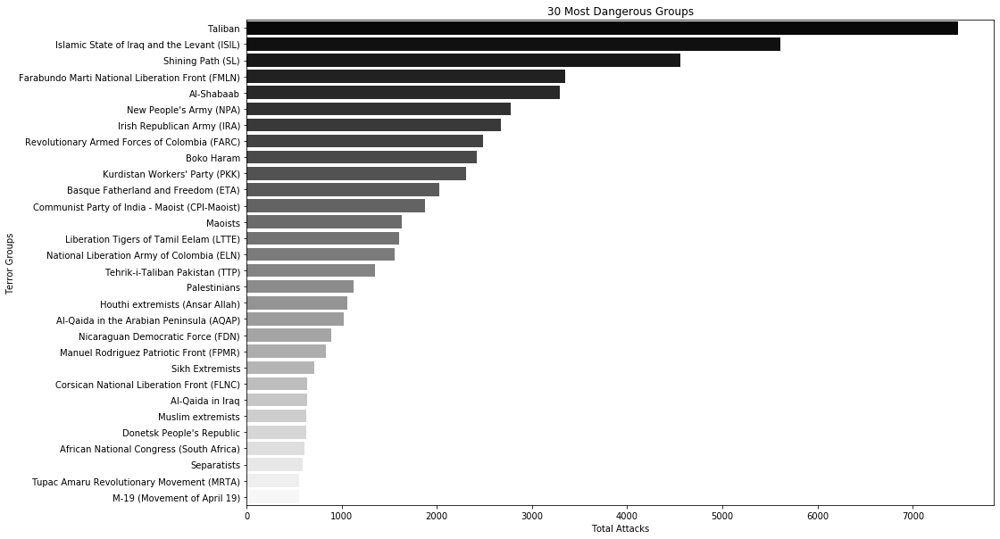

In [21]:
# visualization of City wise terror attacks
top_30_terror_groups = terror_groups.head(30)

plt.figure(figsize=(15,10))

sns.barplot(top_30_terror_groups['total_attacks'], top_30_terror_groups['groups'], palette='gist_gray')
plt.ylabel("Terror Groups")
plt.xlabel("Total Attacks")
plt.title("30 Most Dangerous Groups")
plt.show()

<p>The Taliban, ISIL and Shining Path are the top 3 terror groups that has carried most number of attack over the period of time of their presence

In [22]:
# success rate of the attacks 
success_df = terror_df['success'].value_counts()
success_df = pd.DataFrame(success_df)
success_df = success_df.reset_index()
success_df = success_df.rename(columns = {
    'sucess': 'total_number_of_sucess', 'index': 'efficiency'
    })

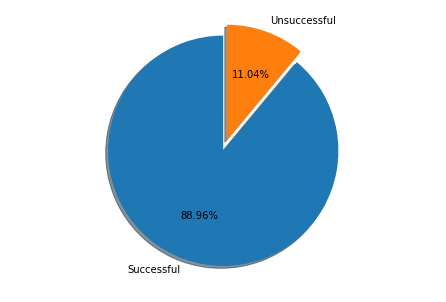

In [116]:
# visualization of success rate of the attacks
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.axis('equal')
labels = ['Successful', 'Unsuccessful']
rate = success_df['success']
explode = (0, 0.1) 
ax.pie(rate, labels = labels,explode = explode, shadow=True, startangle=90, autopct='%1.2f%%')
plt.show('png')

<p> 88.96% of times world fails to stop terror activites

In [24]:
# attack category
attack_category = terror_df['attackType'].value_counts()
attack_category = pd.DataFrame(attack_category)
attack_category = attack_category .reset_index()
attack_category = attack_category .rename(columns = {
    'attackType': 'total_number_of_attack_used', 'index': 'attackType'
    })
# dropping unknown
#attack_category = attack_category.drop([5])

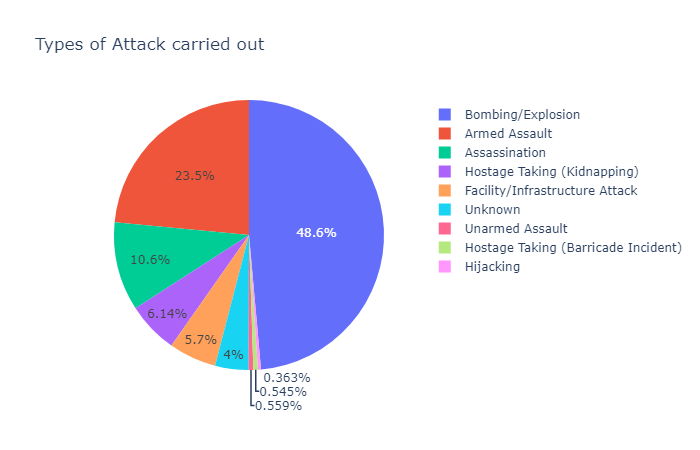

In [115]:
# visualization of attack category
fig = px.pie(attack_category, values = "total_number_of_attack_used", names = "attackType", title = "Types of Attack carried out" ) 
fig.show('png')

<p>The bombing/Explosion comprises around half of the terror activites followed by Armed Assault with 23.5% used attack category in the world

In [26]:
# Most Targetted group of People / Assest/ category
target_category = terror_df['target'].value_counts()
target_category = pd.DataFrame(target_category)
target_category = target_category.sort_index()
target_category = target_category .reset_index()
target_category = target_category .rename(columns = {
    'target': 'total_number_of_times_got_attacked', 'index': 'targets'
    })
# dropping unknown category
target_category=target_category.drop([19])

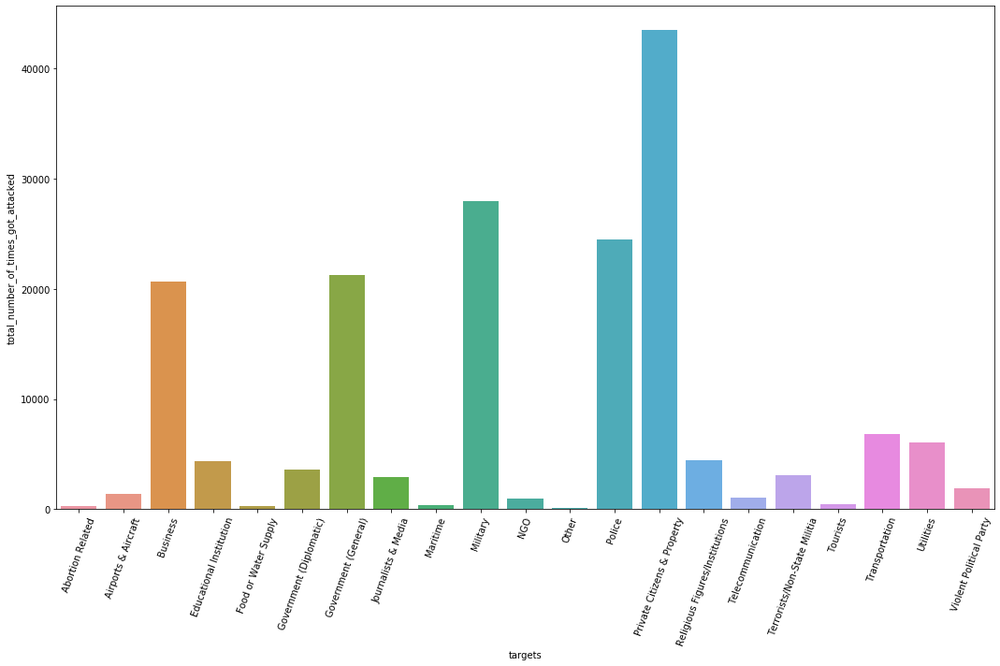

In [27]:
fig = plt.figure(figsize=(15,10))
sns.barplot(x='targets', y='total_number_of_times_got_attacked', data=target_category)
plt.xticks(rotation=70)
plt.tight_layout()

<p>The above plot shows the targetted categories. Among them Private Citizens & Property along followed by Military and Police are most common targets.

## Year Wise terror attacks with respect to World

In [28]:
import folium

In [29]:
# Shows the Map of the world with respect to terror atacks for a particular year
def world_year_map(year):
    year_x = terror_df[terror_df['year'] == year][['latitude','longitude']]
    year_x = year_x.dropna()
    map_x = folium.Map(location =[0,0], tiles='cartodbpositron',zoom_start=2)
    year_x.apply(lambda row:folium.Circle(location=[row["latitude"], row["longitude"]], radius=0, color = 'red' ).add_to(map_x), axis=1)
    return map_x

In [55]:
world_year_map(2014)

#### The above map shows the terror attacks carried out in year 2014 all over the world

## Year Wise terror attacks with respect to Country

In [58]:
# Shows the Map of the country with respect to terror atacks for a period years

def country_year_map(start_year, end_year, country):
    year_x = terror_df[terror_df['year'].between(start_year, end_year)]
    year_x = year_x[year_x['country'] == country][['latitude','longitude']]    
    year_x = year_x.dropna()
    map_x = folium.Map(location=[year_x['latitude'].values[0],year_x['longitude'].values[0]],
                       tiles='cartodbpositron',
                       zoom_start=4
                      )
    
    year_x.apply(lambda row:folium.CircleMarker(location=[row["latitude"], row["longitude"]], radius=1, color = 'red').add_to(map_x), axis=1)
    return map_x

In [59]:
country_year_map(2005, 2009, 'India')

#### The above map shows the terror attacks carried in India from 2005 to 2009

In [33]:
country_year_map(2005, 2014, 'United States')

#### The above map shows the terror attacks carried in United States from 2005 to 2014

## Year Wise terror attacks with respect to Region

In [34]:
def region_year_map(start_year, end_year, region):
    year_x = terror_df[terror_df['year'].between(start_year, end_year)]
    year_x = year_x[year_x['region'] == region][['latitude','longitude']]    
    year_x = year_x.dropna()
    map_x = folium.Map(location=[year_x['latitude'].values[0],year_x['longitude'].values[0]],
                       tiles='cartodbpositron',
                       zoom_start=2.5
                      )
    
    year_x.apply(lambda row:folium.CircleMarker(location=[row["latitude"], row["longitude"]], radius=1, color = 'red').add_to(map_x), axis=1)
    return map_x

In [35]:
region_year_map(2007, 2013, 'Middle East & North Africa')

#### The above map shows the terror attacks carried in Middle East and and North Africa from 2007 to 2013

In [36]:
region_year_map(2014, 2016, 'North America')

#### The above map shows the terror attacks carried in North AMerica from 2014 to 2016

In [37]:
region_year_map(2014, 2016, 'South America')

#### The above map shows the terror attacks carried in South AMerica from 2014 to 2016

In [108]:
# For comparing the terror attacks in region or country or city vs the world
import plotly.graph_objects as go

def s(start_year, end_year, value, col):
    
    year_x = terror_df[terror_df['year'].between(start_year, end_year)]
    
    a = year_x[year_x[col] == value][col]
    b = year_x[year_x[col] != value][col]
    
    a = a.value_counts().sum()
    b = b.value_counts().sum()
    
    c = pd.DataFrame([a,b])
    c.index = [value,'World']
    
    c.columns = ['total_attacks']
    
    fig = px.pie(c, 
             values = c['total_attacks'], names = c.index,
             title = "Total Number of Attacks from "+str(start_year) + ' to ' + str(end_year) + '. World vs '+str(value)) 

    fig.show('png')

def compare_with_world(start_year, end_year, region = '0', country = '0', city = '0'):
    if region != '0':
        s(start_year, end_year, region, col = 'region')
        
    if country != '0':
        s(start_year, end_year, country, col = 'country')
        
    if city != '0':
        s(start_year, end_year,city, col = 'city')

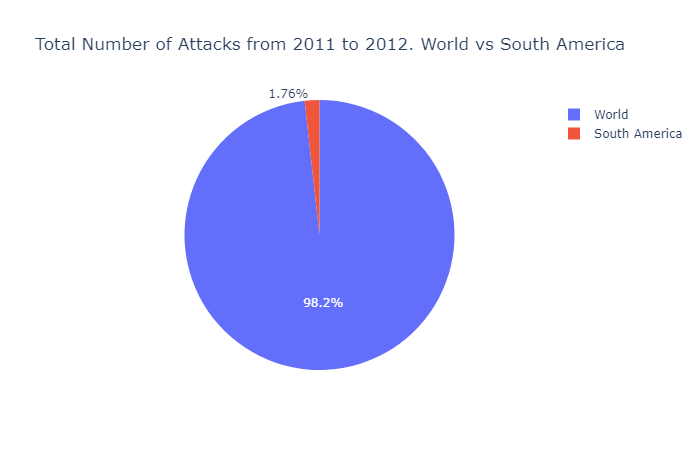

In [109]:
compare_with_world(start_year= 2011, end_year = 2012, region = 'South America')

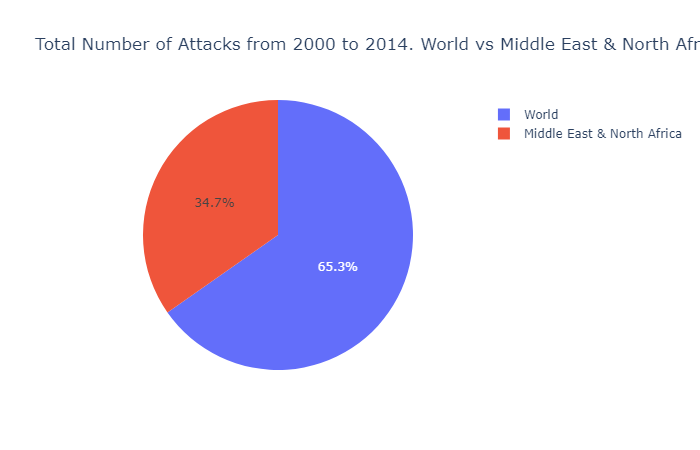

In [110]:
compare_with_world(start_year= 2000, end_year = 2014, region = 'Middle East & North Africa')

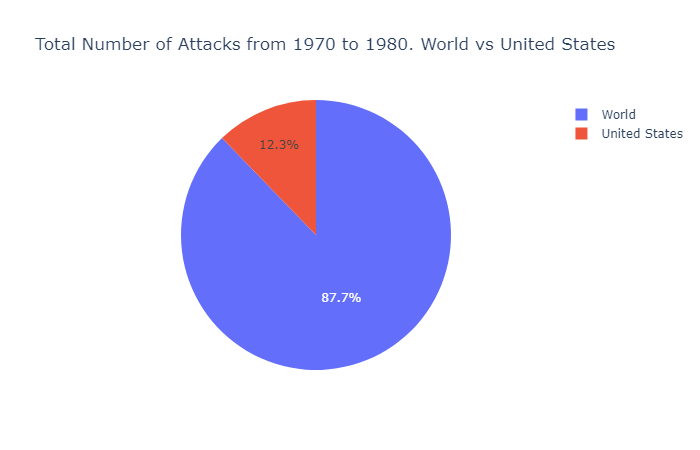

In [111]:
compare_with_world(start_year= 1970, end_year = 1980, country = 'United States')

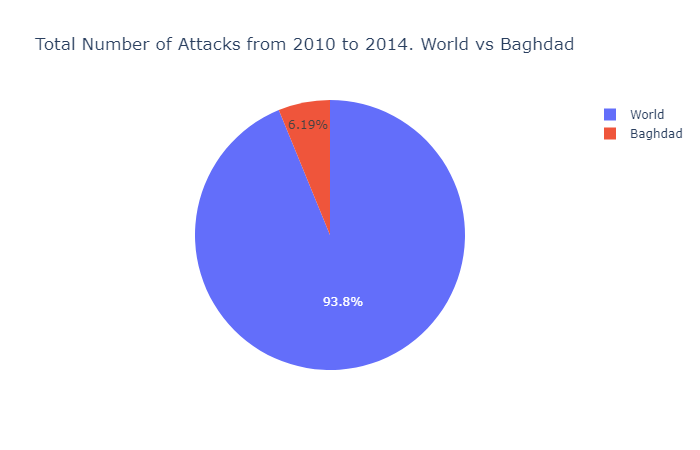

In [112]:
compare_with_world(start_year= 2010, end_year = 2014, city = 'Baghdad')

## Target vs Types

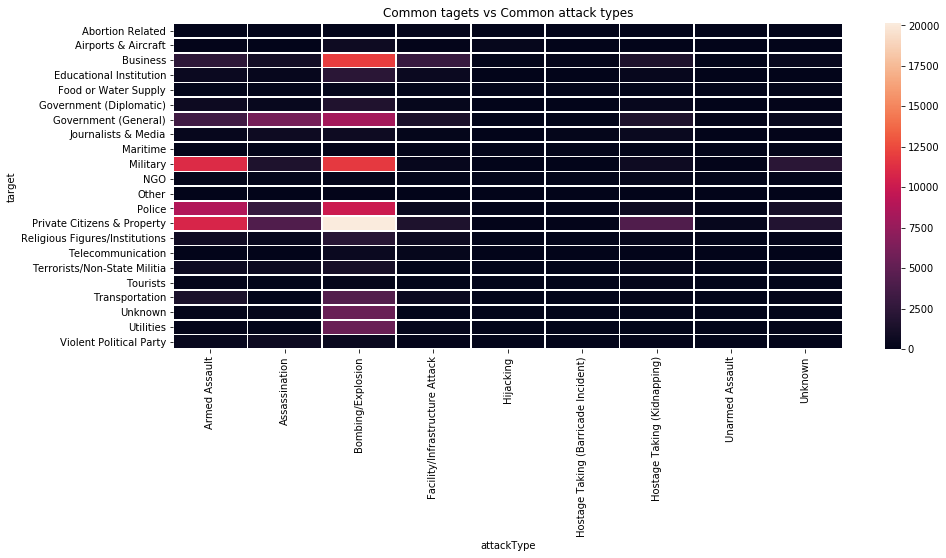

In [70]:
plt.figure(figsize=(15,6))
target_and_types=pd.crosstab(terror_df.target, terror_df.attackType)
sns.heatmap(target_and_types, 
            linewidths=.7).set_title('Common tagets vs Common attack types');

## People Killed vs Wounded in Terror Attacks

In [71]:
kill_and_wounded = terror_df[['kills','wounded']].dropna().sum()
kill_and_wounded = pd.DataFrame(kill_and_wounded)
kill_and_wounded = kill_and_wounded.reset_index()
kill_and_wounded.columns=['cat','total_no']
kill_and_wounded

,cat,total_no
0,kills,351274.0
1,wounded,521618.0


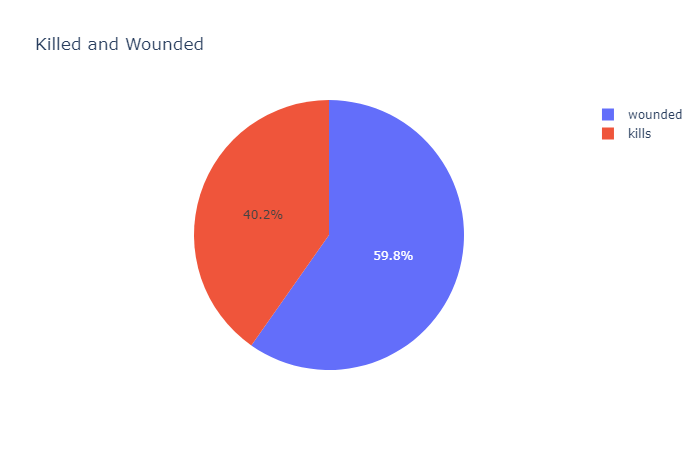

In [113]:
fig = px.pie(kill_and_wounded, 
             values = "total_no", 
             names = "cat", 
             title = "Killed and Wounded") 
fig.show('png')

In [73]:
x = terror_df[['kills','wounded','attackType']].dropna()
list_1 = []
for i in x['attackType'].unique():
    temp = terror_df[terror_df['attackType'] == i][['kills','wounded']].sum()
    list_1.append([i,temp[0], temp[1]])

In [74]:
x = pd.DataFrame(list_1)
x.columns = ['attackType','kills','wounded']
x = pd.melt(x, id_vars=['attackType'], value_vars=['kills','wounded'])
x

,attackType,variable,value
0,Assassination,kills,24920.0
1,Hostage Taking (Kidnapping),kills,24231.0
2,Armed Assault,kills,160297.0
3,Bombing/Explosion,kills,157321.0
4,Facility/Infrastructure Attack,kills,3642.0
5,Hijacking,kills,3718.0
6,Unknown,kills,32381.0
7,Unarmed Assault,kills,880.0
8,Hostage Taking (Barricade Incident),kills,4478.0
9,Assassination,wounded,13887.0


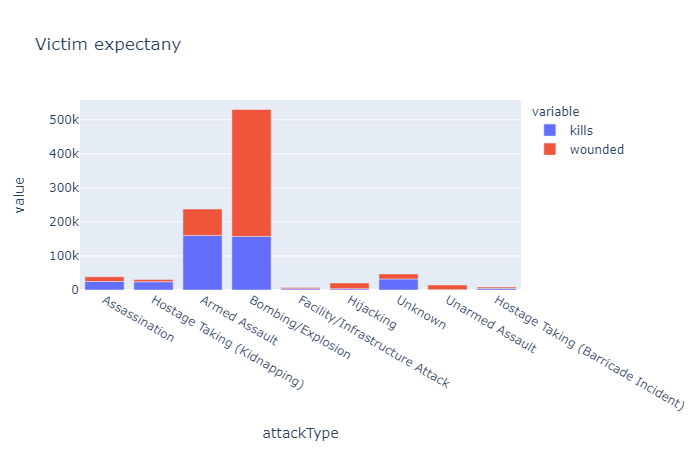

In [114]:
fig = px.bar(x, x="attackType", y="value", color="variable", title="Victim expectany")
fig.show('png')

<p> The Ratio of people getting wounded by getting killed is high in Bombing/Explosion attacks and as well in Hijaking whereas Armed Assault, assassination and Hostage Taking(Kidnapping) has shown high number of people getting killed in the attacks